# CREDIT EDA CASE STUDY

## Introduction

This case study aims to give us an idea of applying EDA in a real business scenario. In this case study, we develop a basic understanding of risk analytics in banking and financial services and understand how data is used to minimise the risk of losing money while lending to customers.

## Problem Statement

To identify patterns which indicate if a client has difficulty paying their installments which may be used for taking actions such as denying the loan, reducing the amount of loan, lending (to risky applicants) at a higher interest rate.
This will ensure that the consumers capable of repaying the loan are not rejected. Identification of such applicants using EDA is the aim of this case study.


Two types of risks are associated with the bank’s decision:

1. If the applicant is likely to repay the loan, then not approving the loan results in a loss of business to the company
2. If the applicant is not likely to repay the loan, i.e. he/she is likely to default, then approving the loan may lead to a financial loss for the company.

## 1. Import Libraries

In [1]:
# Filtering out the warnings
import warnings

warnings.filterwarnings('ignore')

In [2]:
# Importing the required libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

import plotly
from plotly import tools
import plotly.express as px

from mpl_toolkits.mplot3d import Axes3D
from plotly.offline import init_notebook_mode, iplot
import plotly.figure_factory as ff
import cufflinks
cufflinks.go_offline()
cufflinks.set_config_file(world_readable=True)

pd.set_option('display.max_columns', 100)


## 2. Reading the Dataset

In [3]:
#Reading the application_data csv file

app_data = pd.read_csv("application_data.csv")
app_data.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,...,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,...,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,...,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,NaN,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,NaN,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single /

### 2.1 Inspecting the Dataframe

In [4]:
# Checking the number of rows and columns in the dataframe

app_data.shape

(307511, 122)

In [5]:
app_data.info(True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #   Column                        Dtype  
---  ------                        -----  
 0   SK_ID_CURR                    int64  
 1   TARGET                        int64  
 2   NAME_CONTRACT_TYPE            object 
 3   CODE_GENDER                   object 
 4   FLAG_OWN_CAR                  object 
 5   FLAG_OWN_REALTY               object 
 6   CNT_CHILDREN                  int64  
 7   AMT_INCOME_TOTAL              float64
 8   AMT_CREDIT                    float64
 9   AMT_ANNUITY                   float64
 10  AMT_GOODS_PRICE               float64
 11  NAME_TYPE_SUITE               object 
 12  NAME_INCOME_TYPE              object 
 13  NAME_EDUCATION_TYPE           object 
 14  NAME_FAMILY_STATUS            object 
 15  NAME_HOUSING_TYPE             object 
 16  REGION_POPULATION_RELATIVE    float64
 17  DAYS_BIRTH                    int64  
 18  DAYS_EMPLOYED          

In [6]:
# Check the summary for the numeric columns

app_data.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,...,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,134133.000000,3.068510e+05,246546.000000,151450.00000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,...,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,159080.000000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.00000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.502130,5.143927e-01,0.510853,0.11744,0.088442,0.977735,0.752471,0.044621,0.078942,0.149725,0.226282,0.231894,0.066333,0.100775,0.107399,0.008809,0.028358,0.114231,0.087543,0.977065,0.759637,...,0.105645,0.105975,0.008076,0.027022,0.117850,0.087955,0.977752,0.755746,0.044595,0.078078,0.149213,0.225897,0.231625,0.067169,0.101954,0.108607,0.008651,0.028236,0.102547,1.422245,0.143421,1.405292,0.100049,-962.858788,0.000042,0.710023,0.000081,0.015115,0.088055,0.000192

### 2.2 Data Cleaning

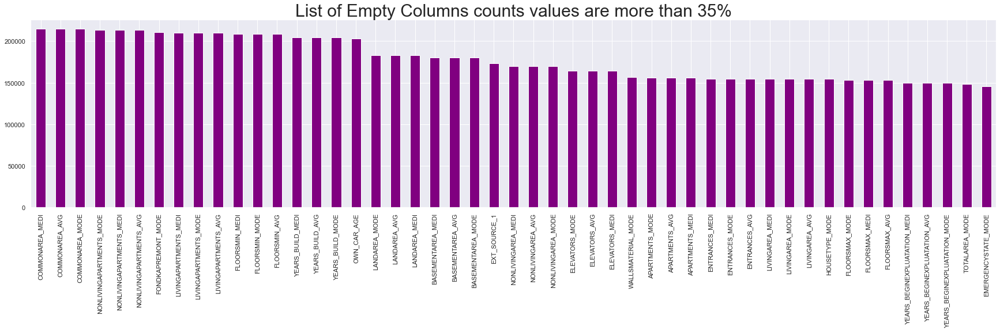

In [7]:
# List of Columns & NA counts where NA values are more than 35%

empty_col = app_data.isnull().sum().sort_values(ascending = False)
empty_col = empty_col[empty_col.values >(0.35 * len(app_data))]
plt.figure(figsize=(30,6))
sns.set(style="darkgrid")
empty_col.plot(kind='bar', color='purple')
plt.title('List of Empty Columns counts values are more than 35%', fontsize=30)
plt.show()

In [8]:
# Number of columns having percentage of null values > 35%

len(empty_col)

49

So, there are 49 columns having null values greater than 35% in the dataset

In [9]:
# Removing those 49 columns

empty_col = list(empty_col[empty_col.values>=0.35].index)
app_data.drop(labels=empty_col,axis=1,inplace=True)
print(len(empty_col))

49


In [10]:
#Percentage of the null values in each of the column

null_perc = app_data.isnull().sum()/len(app_data)*100
null_perc

SK_ID_CURR                     0.000000
TARGET                         0.000000
NAME_CONTRACT_TYPE             0.000000
CODE_GENDER                    0.000000
FLAG_OWN_CAR                   0.000000
                                ...    
AMT_REQ_CREDIT_BUREAU_DAY     13.501631
AMT_REQ_CREDIT_BUREAU_WEEK    13.501631
AMT_REQ_CREDIT_BUREAU_MON     13.501631
AMT_REQ_CREDIT_BUREAU_QRT     13.501631
AMT_REQ_CREDIT_BUREAU_YEAR    13.501631
Length: 73, dtype: float64

So, 'AMT_ANNUITY' columns is having very few null values rows. Hence let's try to impute the missing values.

### 2.3 To impute the Missing Values in some columns

Since this column is having an outlier which is very large it will be inappropriate to fill those missing values with mean, Hence Median comes to rescue for this and we will fill those missing banks with median value

In [11]:
# Filling missing values with median

values = app_data['AMT_ANNUITY'].median()

app_data.loc[app_data['AMT_ANNUITY'].isnull(),'AMT_ANNUITY'] = values

In [12]:
# Searching for the column for null values

app_data.isnull().sum()

SK_ID_CURR                        0
TARGET                            0
NAME_CONTRACT_TYPE                0
CODE_GENDER                       0
FLAG_OWN_CAR                      0
                              ...  
AMT_REQ_CREDIT_BUREAU_DAY     41519
AMT_REQ_CREDIT_BUREAU_WEEK    41519
AMT_REQ_CREDIT_BUREAU_MON     41519
AMT_REQ_CREDIT_BUREAU_QRT     41519
AMT_REQ_CREDIT_BUREAU_YEAR    41519
Length: 73, dtype: int64

Now, all columns have been with zero null values

In [13]:
# Removing rows having null values greater than or equal to 30%

empty_row = app_data.isnull().sum(axis=1)
empty_row = list(empty_row[empty_row.values>=0.3*len(app_data)].index)
app_data.drop(labels=empty_row,axis=0,inplace=True)
print(len(empty_row))

0


In [14]:
# We will remove unwanted columns from this dataset

unwanted_col =['FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE',
       'FLAG_PHONE', 'FLAG_EMAIL','REGION_RATING_CLIENT','REGION_RATING_CLIENT_W_CITY','FLAG_EMAIL','CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT',
       'REGION_RATING_CLIENT_W_CITY','DAYS_LAST_PHONE_CHANGE', 'FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_3','FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6',
       'FLAG_DOCUMENT_7', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_9','FLAG_DOCUMENT_10', 'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_12',
       'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15','FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18',
       'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21']

app_data.drop(labels=unwanted_col, axis=1, inplace=True)

Now, there are some of the columns present where the value is mentioned as 'XNA' which means 'Not Available'. So now we have to find the number of rows and columns & implement the suitable techniques on them by filling all those missing values or delete them.

### 2.4 Errors in the Data types and Data

In [15]:
# Describing the Gender column to check the number of females and males

app_data.CODE_GENDER.value_counts()

F      202448
M      105059
XNA         4
Name: CODE_GENDER, dtype: int64

Since, Female is having the majority and only 4 rows are having NA values, we can update those columns with Gender 'F' as there will be no impact on the dataset.

In [16]:
# let's find these categorical columns having these 'XNA' values
    
# For Gender column

app_data[app_data['CODE_GENDER']=='XNA'].shape

(4, 43)

In [17]:
# For Organization column

app_data[app_data['ORGANIZATION_TYPE']=='XNA'].shape

(55374, 43)

So, We can conclude that there are 4 rows from Gender column and 55374 rows from Organization type column.

In [18]:
# Updating the column 'CODE_GENDER' with "F" for the dataset

app_data.loc[app_data['CODE_GENDER']=='XNA','CODE_GENDER']='F'
app_data['CODE_GENDER'].value_counts()

F    202452
M    105059
Name: CODE_GENDER, dtype: int64

In [19]:
# Describing the organization type column

app_data['ORGANIZATION_TYPE'].describe()

count                     307511
unique                        58
top       Business Entity Type 3
freq                       67992
Name: ORGANIZATION_TYPE, dtype: object

So, 'ORGANIZATION_TYPE' column, we have total count of 307511 rows of which 55374 rows are having 'XNA' values. Which means 18% of the column is having XNA values. Hence if we drop the rows of total 55374, will not have any major impact on our dataset.

In [20]:
# Now, Dropping the rows of total 55374 have 'XNA' values in the organization type column

app_data = app_data.drop(app_data.loc[app_data['ORGANIZATION_TYPE']=='XNA'].index)
app_data[app_data['ORGANIZATION_TYPE']=='XNA'].shape

(0, 43)

In [21]:
# Casting all variable into numeric in the dataset

numeric_columns=['TARGET','CNT_CHILDREN','AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','REGION_POPULATION_RELATIVE','DAYS_BIRTH',
                'DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_ID_PUBLISH','HOUR_APPR_PROCESS_START','LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY']

app_data[numeric_columns] = app_data[numeric_columns].apply(pd.to_numeric)
app_data.head(5)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OCCUPATION_TYPE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,Laborers,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,2.0,2.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,Core staff,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,Laborers,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,Laborers,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,2.0,0.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038,-4311.0,-3458,Core staff,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## 3. Analysis

### 3.1 Finding Outliers

In [22]:
# boxplot for 'AMT_INCOME_TOTAL' column to check the outliers

fig = px.box(app_data, y="AMT_INCOME_TOTAL",title='Distribution of AMT_INCOME_TOTAL' )
fig.show()

Observtion :

Here, in the column 'AMT_INCOME_TOTAL' which tells us the income of the client. We observe a value of 117M which is surely an outlier.

In [23]:
fig = px.box(app_data, y="AMT_ANNUITY",title='Distribution of AMT_ANNUITY' )
fig.show()

Observation:

Here, in the column 'AMT_ANNUITY' which tells the loan annuity. We observe a value which is greater that 258000 which is surely an outlier.

In [24]:
fig = px.box(app_data, y="AMT_CREDIT",title='Distribution of AMT_CREDIT' )
fig.show()

Observations:

Here, in the column 'AMT_CREDIT' which tells the Credit Amount of the client. We observe a value which is greater that 4.05M which is surely an outlier.

Now, Creating bins for continous variable categories column 'AMT_INCOME_TOTAL' and 'AMT_CREDIT'

In [23]:
# we will now check the'AMT_INCOME_TOTAL' and 'AMT_CREDIT' variables
app_data[['AMT_INCOME_TOTAL', 'AMT_CREDIT']].describe()

,AMT_INCOME_TOTAL,AMT_CREDIT
count,2.521370e+05,2.521370e+05
mean,1.759141e+05,6.113985e+05
std,2.588516e+05,4.065272e+05
min,2.565000e+04,4.500000e+04
25%,1.125000e+05,2.779695e+05
50%,1.575000e+05,5.212800e+05
75%,2.115000e+05,8.292240e+05
max,1.170000e+08,4.050000e+06


In [24]:
# Creating bins for income amount

bins = [0,25000,50000,75000,100000,125000,150000,175000,200000,225000,250000,275000,300000,325000,350000,375000,400000,425000,450000,475000,500000,10000000000]
slot = ['0-25000', '25000-50000','50000-75000','75000,100000','100000-125000', '125000-150000', '150000-175000','175000-200000',
       '200000-225000','225000-250000','250000-275000','275000-300000','300000-325000','325000-350000','350000-375000',
       '375000-400000','400000-425000','425000-450000','450000-475000','475000-500000','500000 and above']

app_data['AMT_INCOME_RANGE']=pd.cut(app_data['AMT_INCOME_TOTAL'],bins,labels=slot)
app_data['AMT_INCOME_RANGE'].head()

0    200000-225000
1    250000-275000
2      50000-75000
3    125000-150000
4    100000-125000
Name: AMT_INCOME_RANGE, dtype: category
Categories (21, object): ['0-25000' < '25000-50000' < '50000-75000' < '75000,100000' ... '425000-450000' < '450000-475000' < '475000-500000' < '500000 and above']

In [25]:
# Creating bins for Credit amount

bins = [0,150000,200000,250000,300000,350000,400000,450000,500000,550000,600000,650000,700000,750000,800000,850000,900000,1000000000]
slots = ['0-150000', '150000-200000','200000-250000', '250000-300000', '300000-350000', '350000-400000','400000-450000',
        '450000-500000','500000-550000','550000-600000','600000-650000','650000-700000','700000-750000','750000-800000',
        '800000-850000','850000-900000','900000 and above']

app_data['AMT_CREDIT_RANGE']=pd.cut(app_data['AMT_CREDIT'],bins=bins,labels=slots)
app_data['AMT_CREDIT_RANGE'].head()

0       400000-450000
1    900000 and above
2            0-150000
3       300000-350000
4       500000-550000
Name: AMT_CREDIT_RANGE, dtype: category
Categories (17, object): ['0-150000' < '150000-200000' < '200000-250000' < '250000-300000' ... '750000-800000' < '800000-850000' < '850000-900000' < '900000 and above']

In [26]:
# Dividing the dataset into two dataset of target=1(client with payment difficulties) and target=0(all other)

target0 = app_data.loc[app_data["TARGET"]==0]
target1 = app_data.loc[app_data["TARGET"]==1]

In [27]:
# Calculating Imbalance percentage
    
# Since the majority is target0 and minority is target1

round(len(target0)/len(target1),2)

10.55


The Imbalance ratio is 10.55

#### Checking Imbalance

In [28]:
tid = app_data["TARGET"].value_counts()
df = pd.DataFrame({'labels': tid.index,'values': tid.values})
df.iplot(kind='pie',labels='labels',values='values', title='Target Imbalance Distribution', hole = 0.2)

#### Gender Distribution

In [29]:
# Gender Distibution of Loan Payment with no Difficulties

gd0 = target0["CODE_GENDER"].value_counts()
df = pd.DataFrame({'labels': gd0.index,'values': gd0.values})
df.iplot(kind='pie',labels='labels',values='values', title='Gender Distibution of Loan Payment With NO Difficulties', hole = 0.2)

In [30]:
# Gender Distibution of Loan Payment Difficulties

gd1 = target1["CODE_GENDER"].value_counts()
df = pd.DataFrame({'labels': gd1.index,'values': gd1.values})
df.iplot(kind='pie',labels='labels',values='values', title='Gender Distribution of Loan Payment Difficulties', hole = 0.2)

Observation :

Comaparing the Payment Difficulties and Non Payment Difficulties on the basis of Gender, we observe that Females are the majority in both the cases although there is an increase in the percentage in Male Payment Difficulties from Non-Payment Difficulties

#### Income Sources

In [31]:
# Loan Payment with NO Difficulties are Accompanied by

is0 = target0["NAME_TYPE_SUITE"].value_counts()
df = pd.DataFrame({'labels': is0.index,'values': is0.values})
df.iplot(kind='pie',labels='labels',values='values', title='Loan Payment With NO Difficulties are Accompanyed by', hole = 0.2)

In [32]:
# Loan Payment Difficulties are Accompanied by

is1 = target1["NAME_TYPE_SUITE"].value_counts()
df = pd.DataFrame({'labels': is1.index,'values': is1.values})
df.iplot(kind='pie',labels='labels',values='values', title='Loan Payment Difficulties are Accompanyed by', hole = 0.2)

Obseravtion :

We observe a decrease in the percentage of Payment Difficulties who are pentioners and an increase in the percentage of Payment Difficulties who are working when compared the percentages of both Payment Difficulties and non-Payment Difficulties.

#### Income Range

In [33]:
# Income range of Loan Payment with no Difficulties

ir0 = target0["AMT_INCOME_RANGE"].value_counts()
df = pd.DataFrame({'labels': ir0.index,'values': ir0.values})
df.iplot(kind='pie',labels='labels',values='values', title='Income range of Loan Payment With NO Difficulties', hole = 0.2)

In [34]:
# Income range of Loan Payment Difficulties

ir1 = target1["AMT_INCOME_RANGE"].value_counts()
df = pd.DataFrame({'labels': ir1.index,'values': ir1.values})
df.iplot(kind='pie',labels='labels',values='values', title='Income range of Loan Payment Difficulties', hole = 0.2)

Observation : 

We observe an increase in the percentage of Loan Payment Difficulties whose income is low when compared with the percentages of Payment Difficulties and Loan-Non Payment Difficulties

### 3.2 Categorical Analysis of Numerical Variables on the basis of 'Target' Variable

##### Target 0

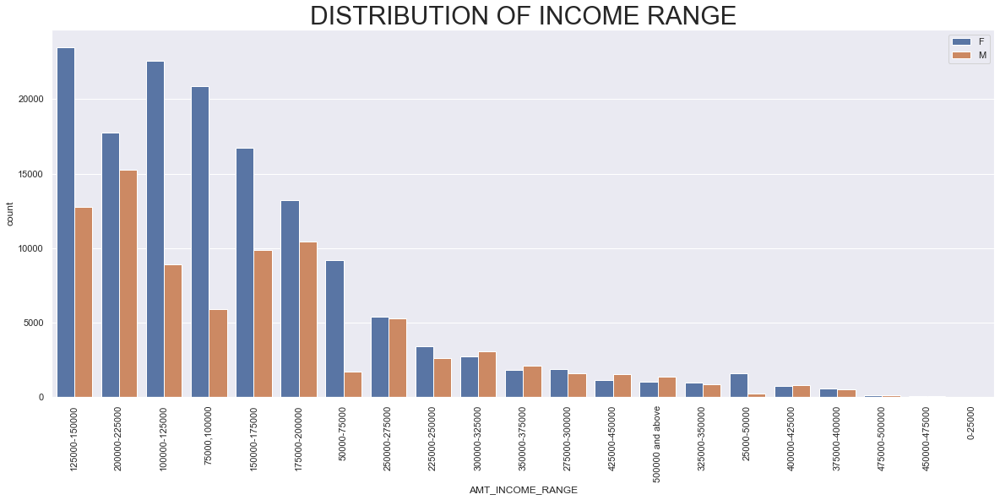

In [35]:
# Count Plotting for Income Range

plt.figure(figsize=(20,8))
sns.set(style="darkgrid")
sns.countplot(data = target0, x= 'AMT_INCOME_RANGE', order=target0['AMT_INCOME_RANGE'].value_counts().index, hue = 'CODE_GENDER')
plt.xticks(rotation=90)
plt.title("DISTRIBUTION OF INCOME RANGE", fontsize = 30)
plt.legend(loc='upper right')
plt.show()

Observation:

1. Female counts are higher than male.
2. Income range from 100000 to 200000 is having more number of the credits.
3. This graph show that females are more than male in having credits for that range.
4. Very less count for income range 400000 and above.

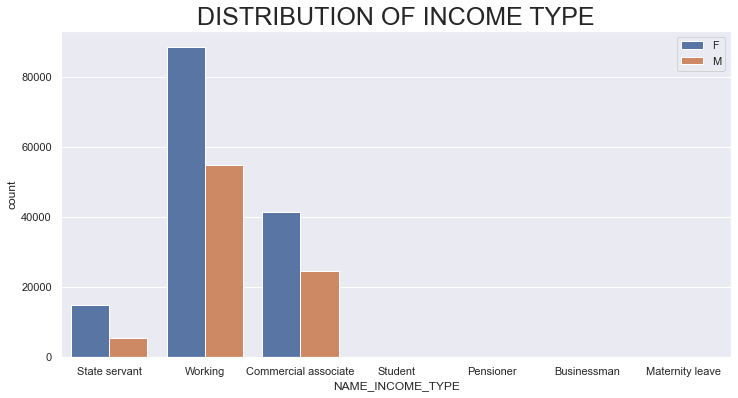

In [36]:
# Count Plotting for Income type for the same

plt.figure(figsize=[12,6]) 
sns.set(style="darkgrid")
sns.countplot(data=target0, x='NAME_INCOME_TYPE', hue='CODE_GENDER')
plt.title('DISTRIBUTION OF INCOME TYPE' , fontsize=25)
plt.xticks(rotation=0)
plt.legend(loc='upper right')
plt.show()

Observation:.

1. ‘Working’, ’Commercial Associate’, and ‘State Servant’ has the high the number of credits than others.
2. Females are having more number of credits than male.
3. Less number of credits for income type ‘Student’ ,'Pensioner’, ‘Businessman’ and ‘Maternity leave’.

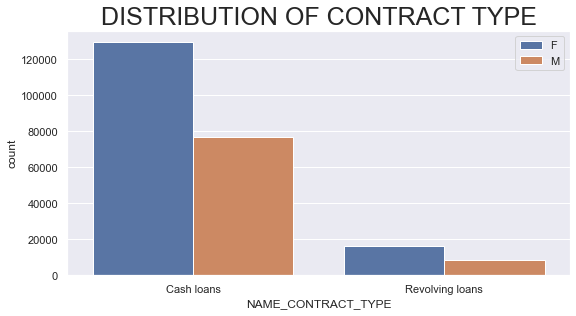

In [37]:
# Count Plotting for Contract type

plt.figure(figsize=[9,4.5]) 
sns.set(style="darkgrid")
sns.countplot(data=target0, x='NAME_CONTRACT_TYPE', hue='CODE_GENDER')
plt.title('DISTRIBUTION OF CONTRACT TYPE' , fontsize=25)
plt.xticks(rotation=0)
plt.legend(loc='upper right')
plt.show()


Observation:

1. ‘Cash loans’ is having higher number of credits than ‘Revolving loans’ contract type.
2. Females are leading in this.

No handles with labels found to put in legend.


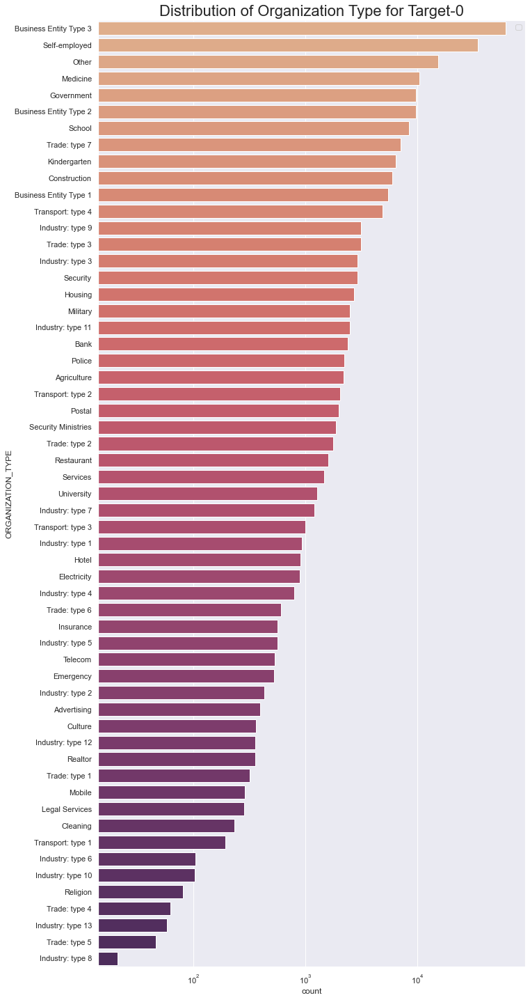

In [38]:
# Count Plotting for Organization type

plt.figure(figsize=[11,25])
sns.set(style="darkgrid")
sns.countplot(data = target0, y='ORGANIZATION_TYPE' , order=target0['ORGANIZATION_TYPE'].value_counts().index, palette='flare')
plt.xticks(rotation=0)
plt.title("Distribution of Organization Type for Target-0", fontsize = 22)
plt.xscale('log')
plt.legend(loc='upper right')
plt.show()

Observation:

1. Clients which have applied for credits are from most of the organization type ‘Business entity Type 3’ , ‘Self employed’, ‘Other’ , ‘Medicine’ , ‘Government’ and 'Business entity Type 2'.

2. Very Less Clients from 'Industry Type 8'.


##### Target 1

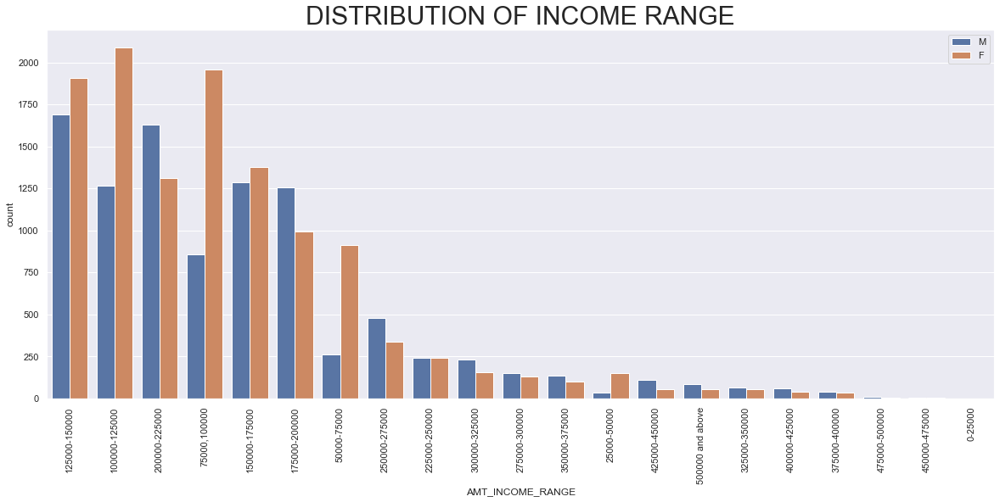

In [39]:
# Count Plotting for Income Range

plt.figure(figsize=[20,8])
sns.set(style="darkgrid")
sns.countplot(data = target1, x= 'AMT_INCOME_RANGE', order=target1['AMT_INCOME_RANGE'].value_counts().index, hue = 'CODE_GENDER')
plt.xticks(rotation=90)
plt.title("DISTRIBUTION OF INCOME RANGE", fontsize = 30)
plt.legend(loc='upper right')
plt.show()

Observation:

1. Female counts are higher than male.
2. Income range from 100000 to 200000 is having more number of credits.
3. This graph show that females are more than male in having credits for that range.
4. Very less count for income range 400000 and less.

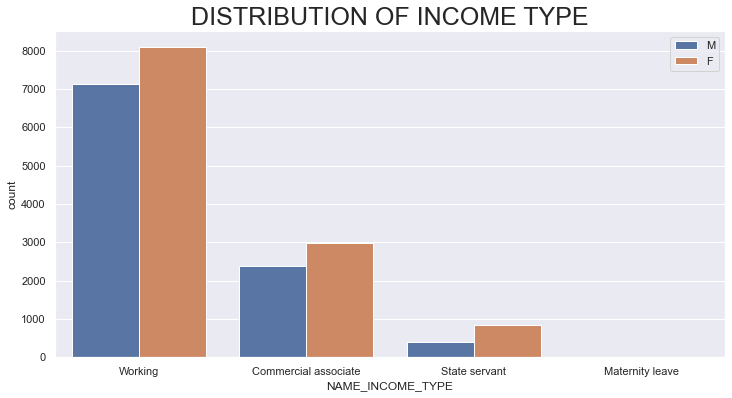

In [40]:
# Count Plotting for Income type for the same

plt.figure(figsize=[12,6]) 
sns.set(style="darkgrid")
sns.countplot(data=target1, x='NAME_INCOME_TYPE', hue='CODE_GENDER')
plt.title('DISTRIBUTION OF INCOME TYPE' , fontsize=25)
plt.xticks(rotation=0)
plt.legend(loc='upper right')
plt.show()

Observation:

1. ‘Working’, ’Commercial associate’, and ‘State Servant’ has higher number of credits than other i.e. ‘Maternity leave.
2. Females are having more number of credits than male.

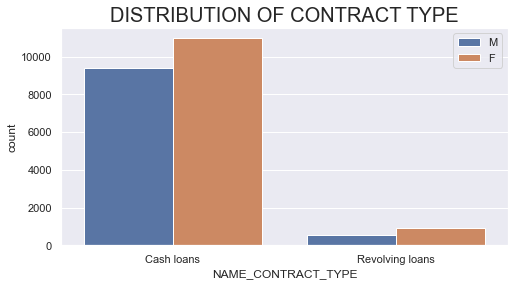

In [41]:
# Count Plotting for Contract type

plt.figure(figsize=[8,4]) 
sns.set(style="darkgrid")
sns.countplot(data=target1, x='NAME_CONTRACT_TYPE', hue='CODE_GENDER')
plt.title('DISTRIBUTION OF CONTRACT TYPE' , fontsize=20)
plt.xticks(rotation=0)
plt.legend(loc='upper right')
plt.show()

Observation: 
1. 'Cash loans’ is having higher number of credits than ‘Revolving loans’ contract type.
2. Female is leading for applying credits.

No handles with labels found to put in legend.


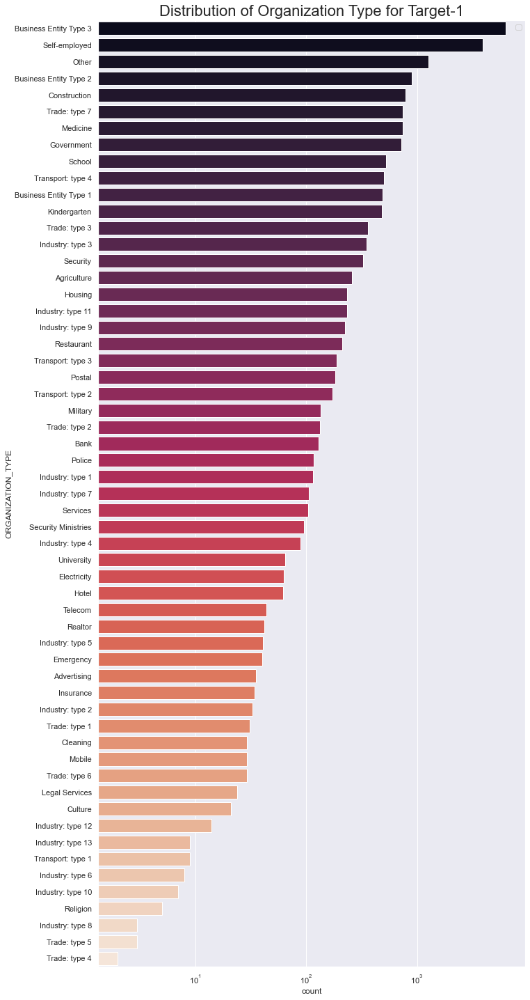

In [42]:
plt.figure(figsize=[11,25])
sns.set(style="darkgrid")
sns.countplot(data = target1, y='ORGANIZATION_TYPE' , order=target1['ORGANIZATION_TYPE'].value_counts().index, palette='rocket')
plt.xticks(rotation=0)
plt.title("Distribution of Organization Type for Target-1", fontsize = 22)
plt.xscale('log')
plt.legend(loc='upper right')
plt.show()

Observation:

1. Clients which have applied for credits are from most of the organization type ‘Business entity Type 3’ , ‘Self employed’, ‘Other’ and 'Business entity Type 2'.

2. Very Less Clients from 'Trade Type 4' , 'Trade Type 5' and 'Trade type 8'.

In [43]:
# Finding some correlation for numerical columns for both target 0 and target 1 

target0_corr = target0.iloc[0:,2:]
target1_corr = target1.iloc[0:,2:]

target0c = target0_corr.corr(method='spearman')
target1c = target1_corr.corr(method='spearman')

In [44]:
# Correlation for target 0

target0c

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
CNT_CHILDREN,1.000000,-0.021950,-0.023652,-0.010795,-0.027086,-0.030579,0.266534,0.030948,0.155518,-0.119164,-0.030162,-0.022813,-0.015475,-0.005576,0.002344,0.007487,0.013295,-0.027456,-0.016471,0.026816,0.005460,0.026536,0.003688,-0.000106,0.001123,-0.000679,-0.013133,-0.001684,-0.035374
AMT_INCOME_TOTAL,-0.021950,1.000000,0.403876,0.472204,0.408533,0.110074,-0.054666,-0.060868,0.040559,-0.036702,0.073503,0.077634,0.159962,0.148281,-0.001023,-0.013856,-0.004758,0.184161,-0.068317,-0.036970,-0.034036,-0.036669,-0.034723,0.002652,0.007412,0.009712,0.069404,0.027260,0.053694
AMT_CREDIT,-0.023652,0.403876,1.000000,0.826689,0.985074,0.060706,-0.169030,-0.104251,-0.015318,-0.038197,0.036923,0.015118,0.041693,0.045175,-0.040616,-0.037000,-0.011194,0.137629,0.044201,-0.001623,-0.018819,-0.001530,-0.021286,-0.004249,0.000323,-0.006210,0.042889,0.028180,-0.036601
AMT_ANNUITY,-0.010795,0.472204,0.826689,1.000000,0.824329,0.064328,-0.100287,-0.074643,0.010712,-0.027354,0.032953,0.033435,0.070841,0.069051,-0.019954,-0.024085,-0.008087,0.131526,0.036769,-0.014584,-0.019623,-0.014335,-0.022262,0.004099,0.002854,0.013346,0.046981,0.027876,0.004549
AMT_GOODS_PRICE,-0.027086,0.408533,0.985074,0.824329,1.000000,0.069899,-0.169016,-0.109327,-0.014986,-0.039785,0.045033,0.016805,0.043047,0.045806,-0.041940,-0.039564,-0.013209,0.146268,0.049438,-0.002392,-0.019924,-0.002256,-0.021782,-0.003442,0.000450,-0.005290,0.044009,0.029176,-0.039098
REGION_POPULATION_RELATIVE,-0.030579,0.110074,0.060706,0.064328,0.069899,1.000000,-0.041663,0.000900,-0.042400,-0.010299,0.133213,-0.025292,0.032446,0.056814,-0.049779,-0.034808,-0.007332,0.197647,-0.009330,0.009504,0.027468,0.010062,0.021781,-0.003992,-0.000289,-0.004859,0.052872,-0.003434,0.002904
DAYS_BIRTH,0.266534,-0.054666,-0.169030,-0.100287,-0.169016,-0.041663,1.000000,0.307787,0.265449,0.083331,0.051299,0.058627,0.038104,0.012789,0.167477,0.111539,0.029007,-0.149414,-0.176196,0.032435,0.021416,0.032063,0.021419,0.002012,0.004305,-0.000282,-0.016461,0.001917,-0.048498
DAYS_EMPLOYED,0.030948,-0.060868,-0.104251,-0.074643,-0.109327,0.000900,0.307787,1.000000,0.126708,0.106823,0.026444,0.065435,0.086966,0.063533,0.118224,0.125954,0.069567,-0.098996,-0.127286,0.000300,0.007688,0.000391,0.008224,-0.003333,0.000361,-0.001334,-0.025654,0.002076,-0.021555
DAYS_REGISTRATION,0.155518,0.040559,-0.015318,0.010712,-0.014986,-0.042400,0.265449,0.126708,1.000000,0.036788,-0.029553,0.017715,0.015092,0.007716,0.038064,0.047339,0.027231,-0.073655,-0.087865,0.019637,0.008927,0.019418,0.008576,-0.003617,0.001121,-0.001013,-0.013694,0.004404,-0.017957
DAYS_ID_PUBLISH,-0.119164,-0.036702,-0.038197,-0.027354,-0.039785,-0.010299,0.083331,0.106823,0.036788,1.000000,0.008538,0.027302,0.020823,0.008525,0.054875,0.033427,0.001476,-0.059711,-0.102442,-0.002631,0.010355,-0.003236,0.012305,0.004880,0.000376,-0.003262,-0.022157,-0.004396,-0.024802


In [45]:
target1c

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
CNT_CHILDREN,1.000000,-0.039123,0.000427,0.015133,-0.005807,-0.029682,0.175025,0.006823,0.110854,-0.091042,-0.040338,-0.035213,-0.040853,-0.027993,-0.016072,-0.005444,0.009557,-0.014702,0.000361,0.034901,-0.001687,0.034091,-0.003596,-0.001663,-0.008511,-0.000225,-0.023875,-0.015079,-0.031603
AMT_INCOME_TOTAL,-0.039123,1.000000,0.364559,0.428947,0.369419,0.058005,-0.103026,-0.053798,0.011378,-0.051113,0.078779,0.075615,0.156374,0.145982,-0.003813,-0.006241,0.004230,0.151537,-0.048537,-0.006082,-0.026784,-0.006269,-0.028520,0.008880,-0.005336,0.022686,0.079420,0.023812,0.075815
AMT_CREDIT,0.000427,0.364559,1.000000,0.812093,0.976307,0.043545,-0.200718,-0.107605,-0.021973,-0.065143,0.024616,0.015043,0.032536,0.034861,-0.030974,-0.032882,-0.012465,0.120180,0.083735,0.016914,-0.028261,0.016878,-0.033856,0.001727,-0.006975,0.005325,0.045339,-0.014407,-0.024635
AMT_ANNUITY,0.015133,0.428947,0.812093,1.000000,0.806543,0.028666,-0.100200,-0.060193,0.019762,-0.044128,0.021129,0.029646,0.060363,0.059724,-0.011744,-0.015938,-0.003012,0.115647,0.050873,0.004732,-0.022101,0.005796,-0.026456,0.013317,-0.003764,0.036961,0.064217,0.002151,-0.000332
AMT_GOODS_PRICE,-0.005807,0.369419,0.976307,0.806543,1.000000,0.058424,-0.198895,-0.116050,-0.023020,-0.069227,0.037317,0.018467,0.036913,0.038112,-0.031660,-0.034358,-0.012493,0.132749,0.088721,0.018873,-0.025434,0.018839,-0.030639,0.004719,-0.007290,0.008210,0.049196,-0.011431,-0.025823
REGION_POPULATION_RELATIVE,-0.029682,0.058005,0.043545,0.028666,0.058424,1.000000,-0.044444,-0.015246,-0.033490,-0.017779,0.109400,-0.032702,-0.008160,0.012602,-0.057239,-0.044761,-0.014753,0.146325,-0.016356,0.029384,0.046274,0.028805,0.035418,-0.005374,0.001482,0.001967,0.048764,-0.013118,0.003999
DAYS_BIRTH,0.175025,-0.103026,-0.200718,-0.100200,-0.198895,-0.044444,1.000000,0.256870,0.192350,0.146246,0.041994,0.046320,0.022208,0.000356,0.145884,0.096181,0.009633,-0.148767,-0.145411,0.003336,0.018240,0.002628,0.022451,0.016053,0.010904,0.004496,-0.014389,-0.005095,-0.083081
DAYS_EMPLOYED,0.006823,-0.053798,-0.107605,-0.060193,-0.116050,-0.015246,0.256870,1.000000,0.086286,0.104244,0.010328,0.069566,0.082264,0.056081,0.118869,0.139863,0.069316,-0.092893,-0.083823,-0.024303,0.006929,-0.024561,0.009199,0.009595,0.012561,0.005189,-0.015619,0.012093,-0.054224
DAYS_REGISTRATION,0.110854,0.011378,-0.021973,0.019762,-0.023020,-0.033490,0.192350,0.086286,1.000000,0.061563,-0.044753,0.006362,0.000896,-0.001416,0.015831,0.039204,0.026105,-0.074527,-0.059671,0.022984,0.012926,0.022657,0.010911,0.001012,0.004603,0.007750,0.010763,-0.004570,-0.012863
DAYS_ID_PUBLISH,-0.091042,-0.051113,-0.065143,-0.044128,-0.069227,-0.017779,0.146246,0.104244,0.061563,1.000000,0.012709,0.024860,0.013162,0.002567,0.048184,0.015838,-0.015598,-0.066761,-0.111111,-0.013372,0.013556,-0.012960,0.012582,0.003863,-0.012106,0.005676,-0.019588,0.013041,-0.046824


#### Top 10 Correlation for client with payment difficulties

In [46]:
corr=target1[['AMT_GOODS_PRICE','AMT_INCOME_TOTAL','AMT_ANNUITY','DAYS_EMPLOYED',
  'DAYS_BIRTH', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
  'AMT_CREDIT']].corr(method = 'pearson')
corr=corr.where(np.triu(np.ones(corr.shape),k=1).astype(np.bool))
corr_df=corr.unstack().reset_index()

In [47]:
corr_df.columns = ['VAR1','VAR2','CORRELATION']
corr_df.dropna(subset=['CORRELATION'],inplace=True)
corr_df['CORR_ABS']=corr_df['CORRELATION'].abs()

In [48]:
corr_df.sort_values('CORR_ABS', ascending=False).head(10)

,VAR1,VAR2,CORRELATION,CORR_ABS
56,AMT_CREDIT,AMT_GOODS_PRICE,0.982799,0.982799
16,AMT_ANNUITY,AMT_GOODS_PRICE,0.749379,0.749379
58,AMT_CREDIT,AMT_ANNUITY,0.748708,0.748708
35,DAYS_BIRTH,DAYS_EMPLOYED,0.307018,0.307018
44,DAYS_REGISTRATION,DAYS_BIRTH,0.241202,0.241202
60,AMT_CREDIT,DAYS_BIRTH,-0.189512,0.189512
32,DAYS_BIRTH,AMT_GOODS_PRICE,-0.185578,0.185578
43,DAYS_REGISTRATION,DAYS_EMPLOYED,0.137454,0.137454
52,DAYS_ID_PUBLISH,DAYS_BIRTH,0.135519,0.135519
24,DAYS_EMPLOYED,AMT_GOODS_PRICE,-0.111933,0.111933


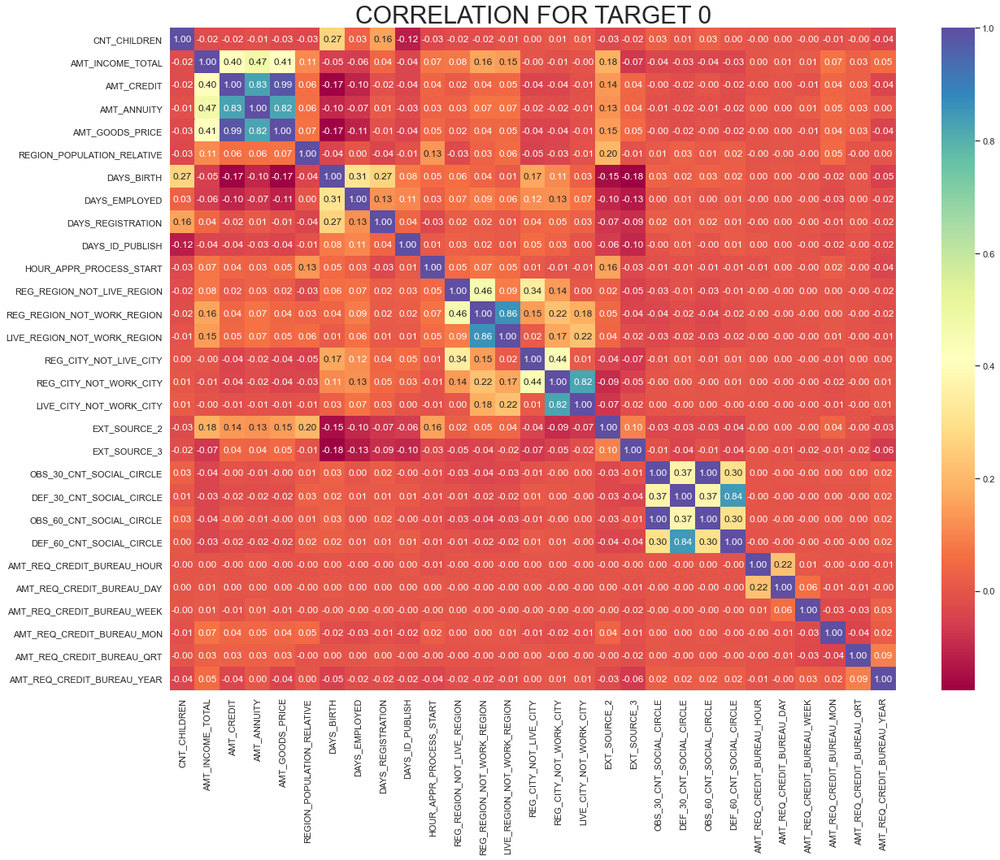

In [49]:
# Heatmap for target 0

plt.figure(figsize=(20,15))
sns.heatmap(data=target0c, cmap="Spectral", fmt='.2f', annot=True)
plt.title('CORRELATION FOR TARGET 0' , fontsize=30)
plt.show()


Observation:

1. Credit amount is inversely proportional to the date of birth, which means Credit amount is higher for low age and vice-versa.
2. Credit amount is inversely proportional to the number of children client have, means Credit amount is higher for less children count client have and vice-versa.
3. Income amount is inversely proportional to the number of children client have, means more income for less children client have and vice-versa.
4. Less children client have in densely populated area.
5. The income is higher in densely populated area.
6. Credit amount is higher in densely populated area.

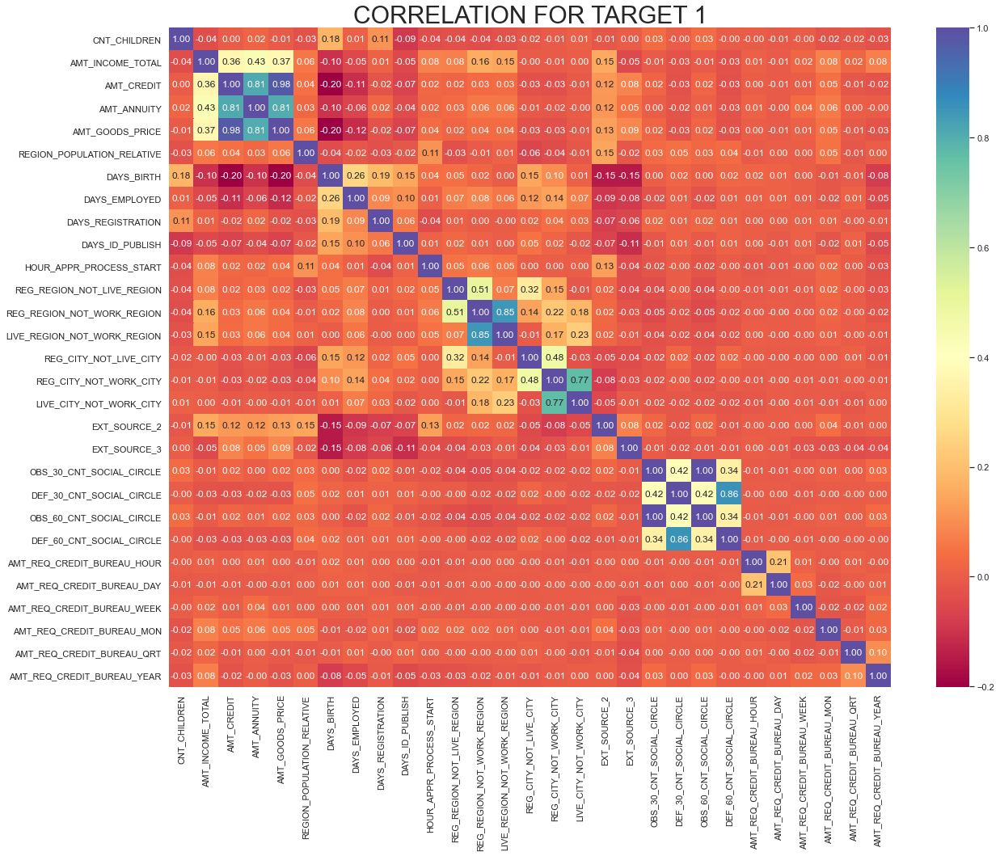

In [50]:
# Heatmap for target 1

plt.figure(figsize=(20,15))
sns.heatmap(data = target1c, cmap="Spectral", fmt='.2f', annot=True)
plt.title('CORRELATION FOR TARGET 1' , fontsize=30)
plt.show()


Observation: 

Heat map for Target 1 is also having little bit same observation just like Target 0. But for few points are different. They are listed below.

1. Client's permanent address does not match to contact address which are having less children and vice-versa
2. Client's permanent address does not match to work address which are having less children and vice-versa

### 3.3 Univariate Analysis of Numerical Variables

In [51]:
# Function for univariate plots
def univariate(df,col,hue =None):
    sns.set(style="darkgrid")
    plt.figure(figsize=[7,7])
    plt.title("Box Plot")
    sns.boxplot(data =df, y=col, orient='v', color="#69d")
    plt.yscale('log')
    plt.show()

#### Loan Annuity

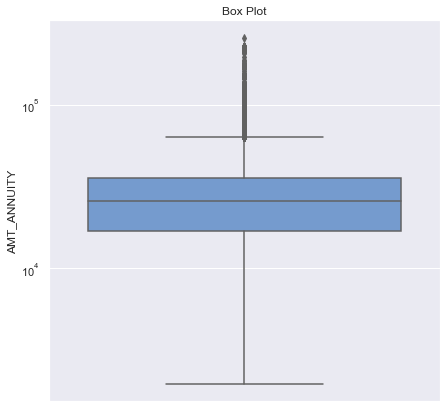

In [52]:
# Distribution and Box plot for 'AMT_ANNUITY' for Loan Payment with No Difficulties
univariate(df=target0,col='AMT_ANNUITY')

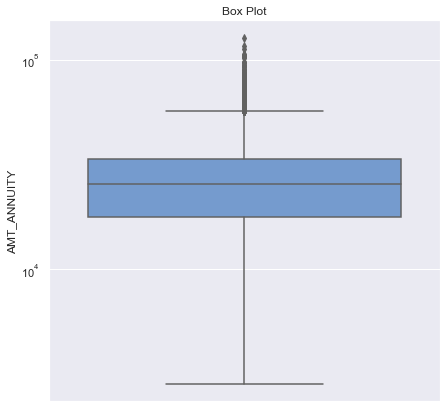

In [53]:
# Distribution and Box plot for 'AMT_ANNUITY' for Loan- Payment Difficulties
univariate(df=target1,col='AMT_ANNUITY')

Observations:
1. Some outliers are noticed in income amount.
2. The first quartile is bigger than third quartile for annuity amount which means most of the annuity clients are from first quartile.

#### Credit Amount

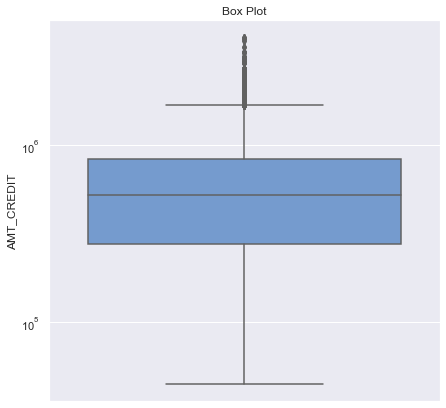

In [54]:
# Distribution and Box plot for 'AMT_CREDIT' for Loan Payment with NO Difficulties
univariate(df=target0,col='AMT_CREDIT')

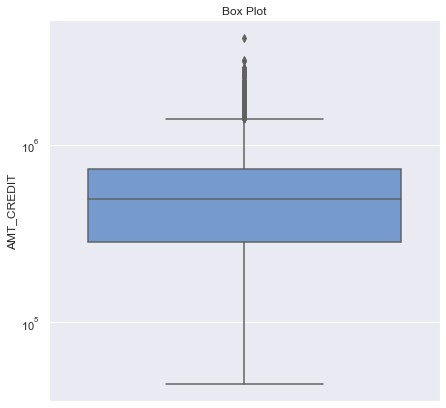

In [55]:
# Distribution and Box plot for 'AMT_CREDIT' for Loan Payment Difficulties
univariate(df=target1,col='AMT_CREDIT')

Observations:

1. Some outliers are noticed in credit amount.
2. The first quartile is bigger than third quartile for credit amount which means most of the credits of clients are present in the first quartile.

#### Goods Price

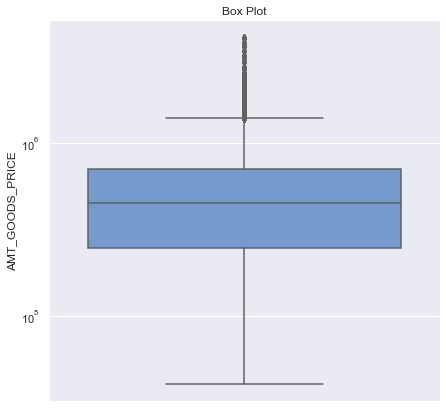

In [56]:
# Distribution and Box plot for 'AMT_GOODS_PRICE' for Loan Payment with NO Difficulties
univariate(df=target0,col='AMT_GOODS_PRICE')

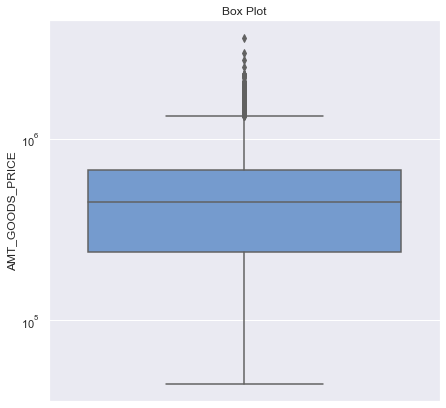

In [57]:
# Distribution and Box plot for 'AMT_GOODS_PRICE' for Loan-Payment Difficulties
univariate(df=target1,col='AMT_GOODS_PRICE')

Observations:

1. Some outliers are noticed in annuity amount.
2. The first quartile is bigger than third quartile for goods amount which means most of the goods clients are from first quartile.

### 3.4 Bivariate Analysis for Numerical Variables

##### Credit Amount vs Education Status

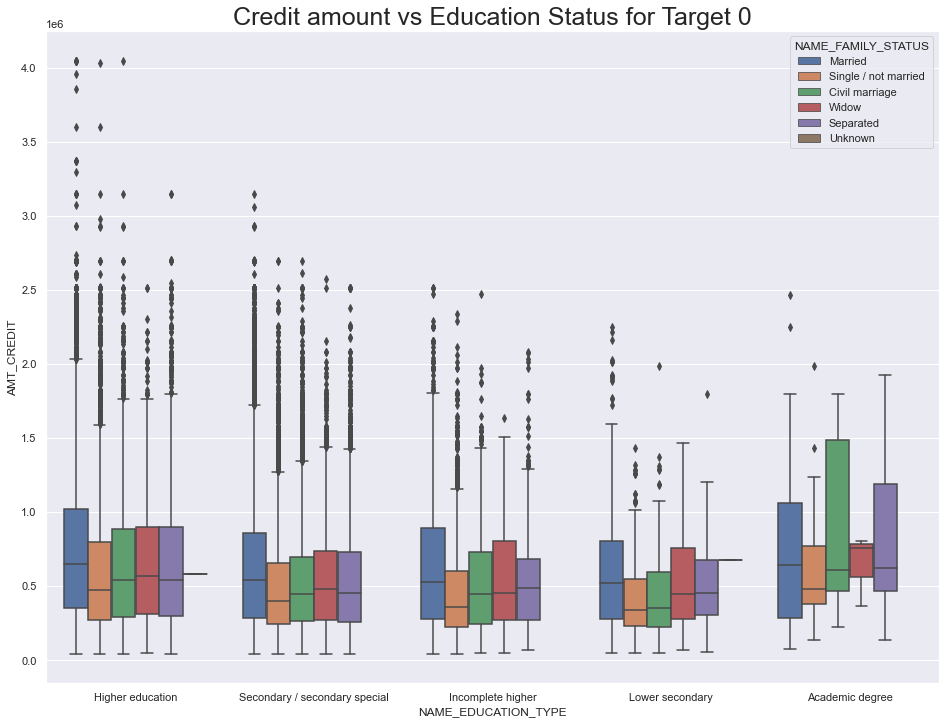

In [58]:
# Box plotting for Credit amount for Target 0

plt.figure(figsize=(16,12))
sns.set(style="darkgrid")
sns.boxplot(data =target0, x='NAME_EDUCATION_TYPE',y='AMT_CREDIT', hue ='NAME_FAMILY_STATUS',orient='v')
plt.title('Credit amount vs Education Status for Target 0', fontsize = 25)
plt.show()

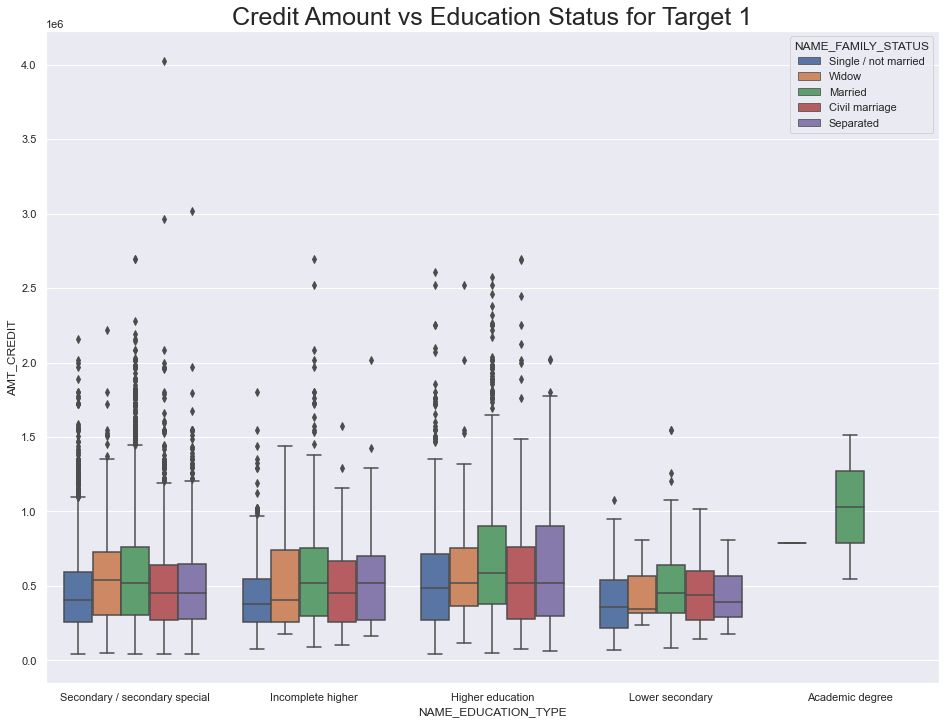

In [59]:
# Box plotting for credit amount for target 1

plt.figure(figsize=(16,12))
sns.set(style="darkgrid")
sns.boxplot(data =target1, x='NAME_EDUCATION_TYPE',y='AMT_CREDIT', hue ='NAME_FAMILY_STATUS',orient='v')
plt.title('Credit Amount vs Education Status for Target 1', fontsize=25)
plt.show()

Observation :

Here we can see that the range of customers without payment of Academic degree is higher than the customer of with payment. And the rest of the Education type is almost same for both the cases.

##### Income Amount vs Education Status

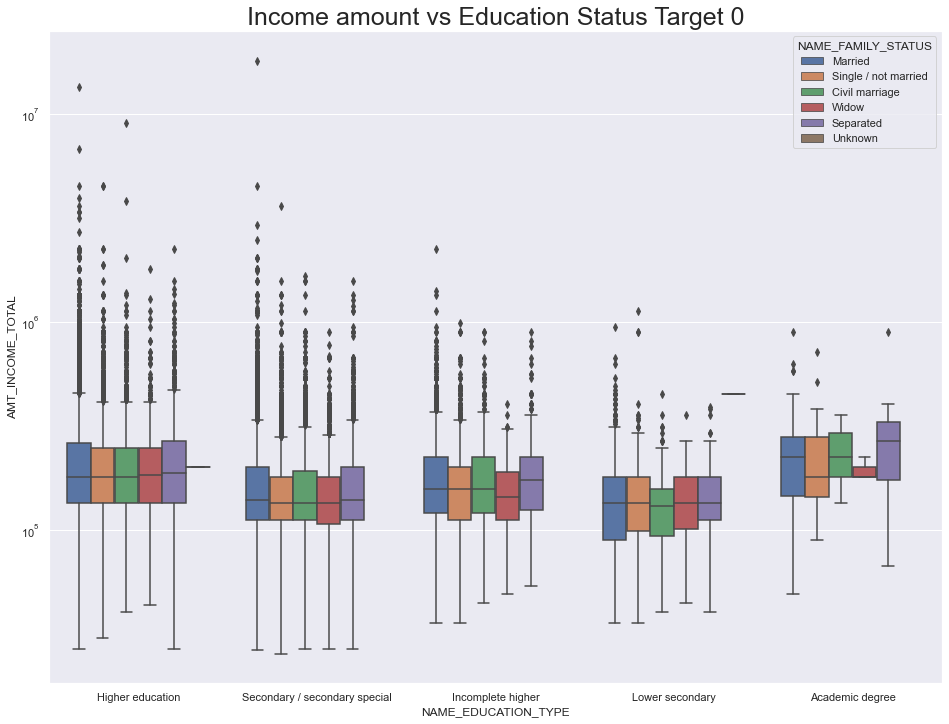

In [60]:
#Target 0
# Box plotting for Income amount in logarithmic scale

plt.figure(figsize=(16,12))
sns.set(style="darkgrid")
plt.yscale('log')
sns.boxplot(data =target0, x='NAME_EDUCATION_TYPE',y='AMT_INCOME_TOTAL', hue ='NAME_FAMILY_STATUS',orient='v')
plt.title('Income amount vs Education Status Target 0', fontsize=25)
plt.show()

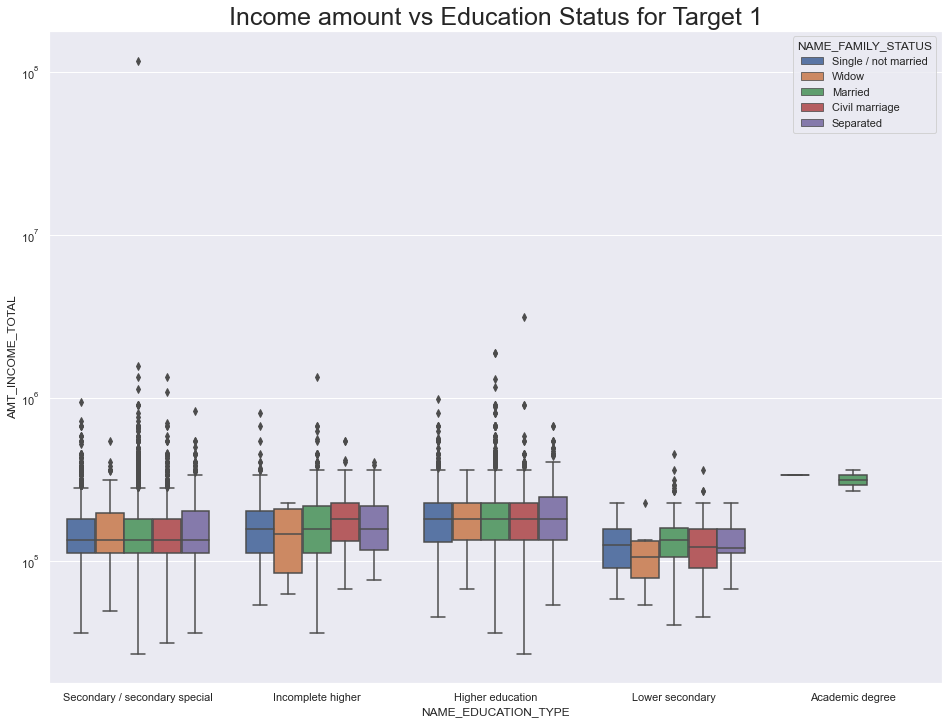

In [61]:
#Target 1
# Box plotting for Income amount in logarithmic scale

plt.figure(figsize=(16,12))
sns.set(style="darkgrid")
plt.yscale('log')
sns.boxplot(data =target1, x='NAME_EDUCATION_TYPE',y='AMT_INCOME_TOTAL', hue ='NAME_FAMILY_STATUS',orient='v')
plt.title('Income amount vs Education Status for Target 1',fontsize=25)
plt.show()

Observation:

Here we can see that the customers without payment is having more outliers as compare to the customer with payment.

##### Credit Amount vs Occupation Type

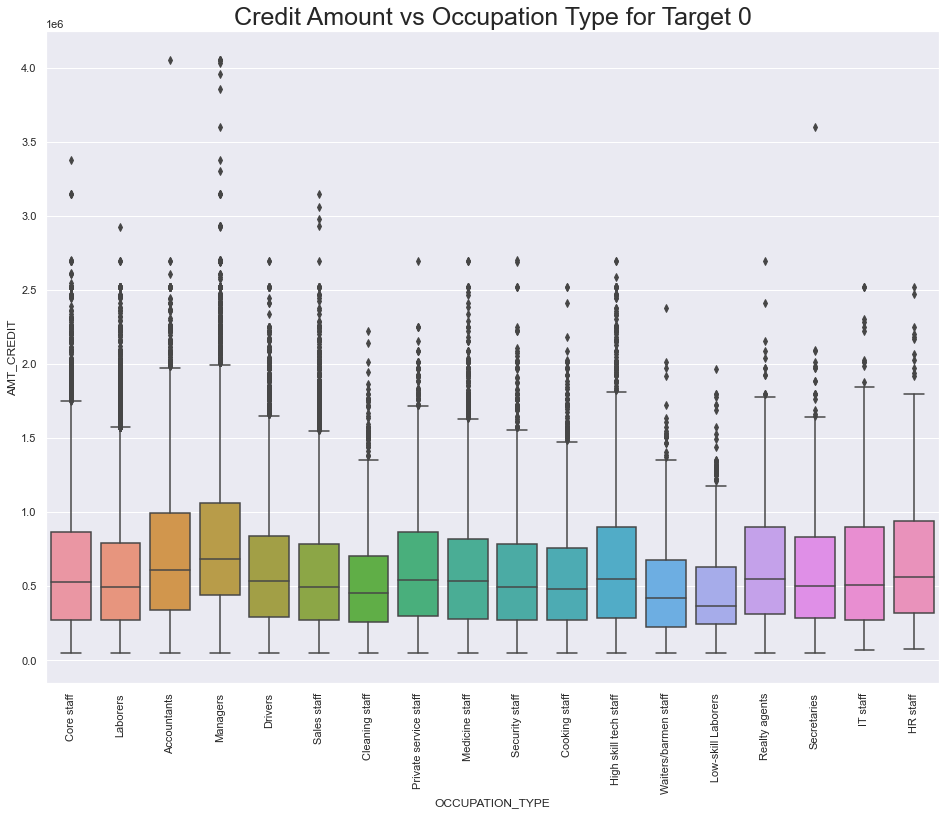

In [62]:
# Box plotting for credit amount for target 0

plt.figure(figsize=(16,12))
sns.set(style="darkgrid")
sns.boxplot(data =target0, x='OCCUPATION_TYPE', y='AMT_CREDIT')
plt.title('Credit Amount vs Occupation Type for Target 0', fontsize=25)
plt.xticks(rotation=90)
plt.show()

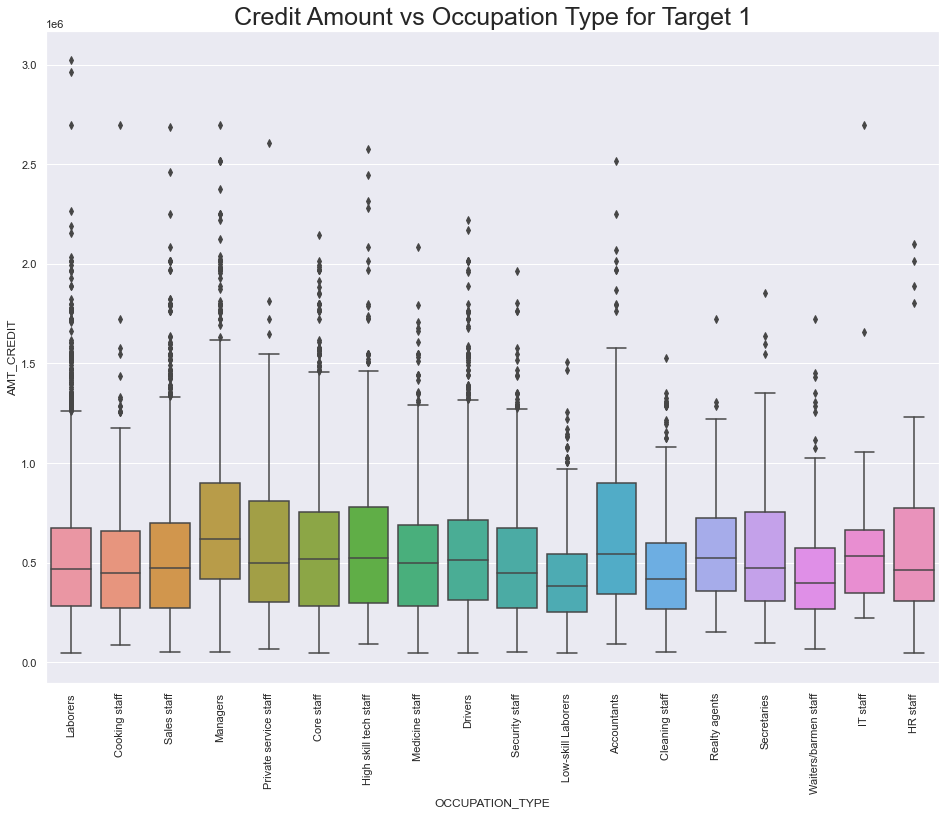

In [63]:
# Box plotting for credit amount for target 1

plt.figure(figsize=(16,12))
sns.set(style="darkgrid")
sns.boxplot(data =target1, x='OCCUPATION_TYPE',y='AMT_CREDIT')
plt.title('Credit Amount vs Occupation Type for Target 1', fontsize=25)
plt.xticks(rotation=90)
plt.show()

Observation :

Here we can see that the range of the customers without payment more as compare to the customers with payment.

### 3.5 Bivariate Analysis of Numerical vs Numerical Variables

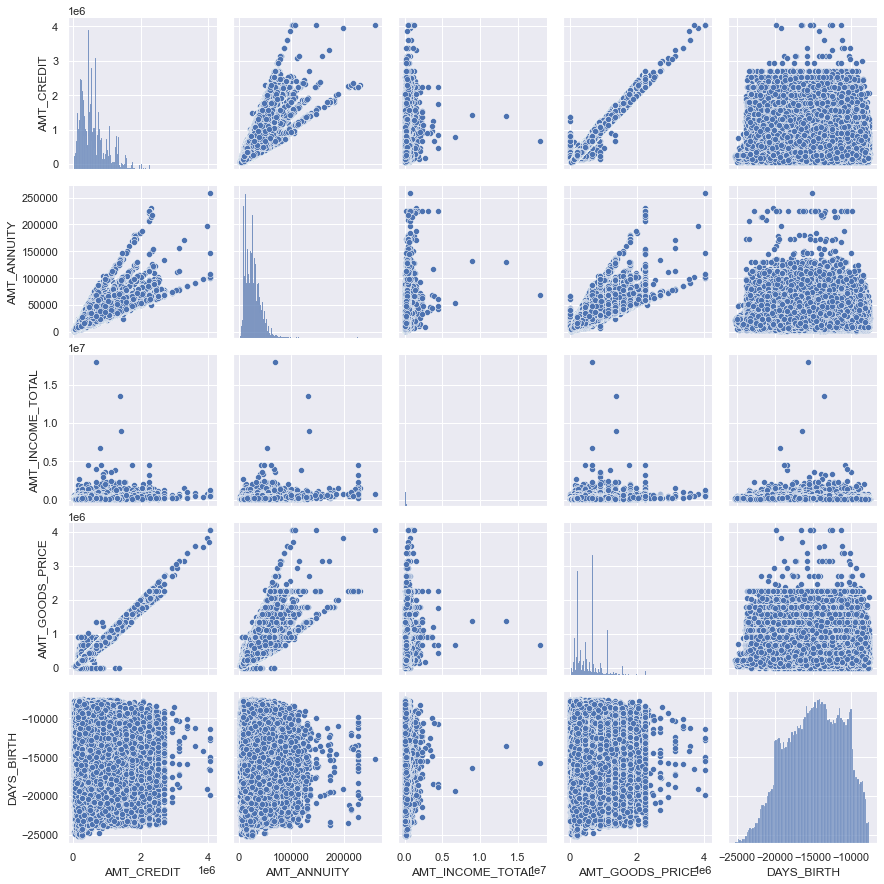

In [64]:
#Pairplot for Target 0 (Loan Payment with NO Difficulties)

pair = target0[['AMT_CREDIT', 'AMT_ANNUITY', 'AMT_INCOME_TOTAL', 'AMT_GOODS_PRICE', 'DAYS_BIRTH']].fillna(0)
sns.pairplot(pair)
plt.show()

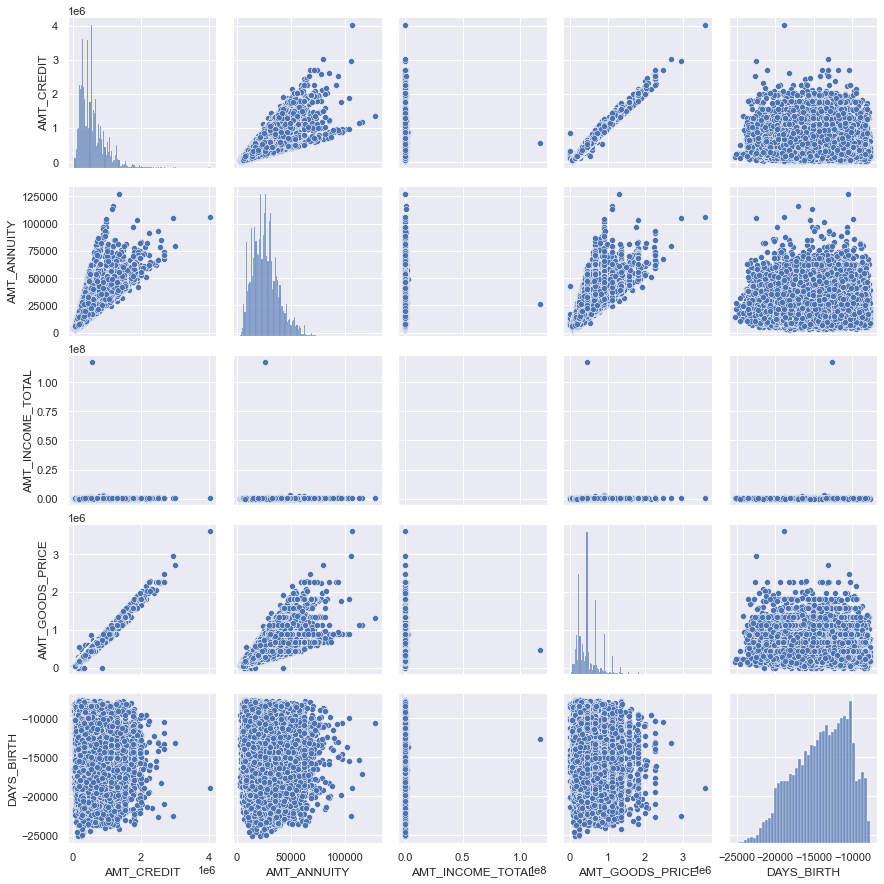

In [65]:
#Pairplot for Target 1 (Loan-Payment Difficulties)

pair = target1[['AMT_CREDIT', 'AMT_ANNUITY', 'AMT_INCOME_TOTAL', 'AMT_GOODS_PRICE', 'DAYS_BIRTH']].fillna(0)
sns.pairplot(pair)
plt.show()

Observation:

We observe that there is a high correlation between credit amount and goods price. There appears to be some deviancies in the correlation of Loan-Payment Difficulties and Loan Payment with No Difficulties such as credit amount v/s income.

## 4. Data Analysis on Previous Application data

### 4.1 Reading and Inspecting the Previous Application Data

In [66]:
#reading the previous application file
prev_app = pd.read_csv('previous_application.csv')
prev_app.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [67]:
#checking the shape of the file
prev_app.shape

(1670214, 37)

In [68]:
#checking the info about the file
prev_app.info(True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [69]:
#checking the percentiles, min values for the file
prev_app.describe()

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1.670214e+06,1.670214e+06,1.297979e+06,1.670214e+06,1.670213e+06,7.743700e+05,1.284699e+06,1.670214e+06,1.670214e+06,774370.000000,5951.000000,5951.000000,1.670214e+06,1.670214e+06,1.297984e+06,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
mean,1.923089e+06,2.783572e+05,1.595512e+04,1.752339e+05,1.961140e+05,6.697402e+03,2.278473e+05,1.248418e+01,9.964675e-01,0.079637,0.188357,0.773503,-8.806797e+02,3.139511e+02,1.605408e+01,342209.855039,13826.269337,33767.774054,76582.403064,81992.343838,0.332570
std,5.325980e+05,1.028148e+05,1.478214e+04,2.927798e+05,3.185746e+05,2.092150e+04,3.153966e+05,3.334028e+00,5.932963e-02,0.107823,0.087671,0.100879,7.790997e+02,7.127443e+03,1.456729e+01,88916.115834,72444.869708,106857.034789,149647.415123,153303.516729,0.471134
min,1.000001e+06,1.000010e+05,0.000000e+00,0.000000e+00,0.000000e+00,-9.000000e-01,0.000000e+00,0.000000e+00,0.000000e+00,-0.000015,0.034781,0.373150,-2.922000e+03,-1.000000e+00,0.000000e+00,-2922.000000,-2892.000000,-2801.000000,-2889.000000,-2874.000000,0.000000
25%,1.461857e+06,1.893290e+05,6.321780e+03,1.872000e+04,2.416050e+04,0.000000e+00,5.084100e+04,1.000000e+01,1.000000e+00,0.000000,0.160716,0.715645,-1.300000e+03,-1.000000e+00,6.000000e+00,365243.000000,-1628.000000,-1242.000000,-1314.000000,-1270.000000,0.000000
50%,1.923110e+06,2.787145e+05,1.125000e+04,7.104600e+04,8.054100e+04,1.638000e+03,1.123200e+05,1.200000e+01,1.000000e+00,0.051605,0.189122,0.835095,-5.810000e+02,3.000000e+00,1.200000e+01,365243.000000,-831.000000,-361.000000,-537.000000,-499.000000,0.000000
75%,2.384280e+06,3.675140e+05,2.065842e+04,1.803600e+05,2.164185e+05,7.740000e+03,2.340000e+05,1.500000e+01,1.000000e+00,0.108909,0.193330,0.852537,-2.800000e+02,8.200000e+01,2.400000e+01,365243.000000,-411.000000,129.000000,-74.000000,-44.000000,1.000000
max,2.845382e+06,4.562550e+05,4.180581e+05,6.905160e+06,6.905160e+06,3.060045e+06,6.905160e+06,2.300000e+01,1.000000e+00,1.000000,1.000000,1.000000,-1.000000e+00,4.000000e+06,8.400000e+01,365243.000000,365243.000000,365243.000000,365243.000000,365243.000000,1.000000


### 4.2 Cleaning of Previous Application Data

In [70]:
# Cleaning the missing data

# listing the null values columns having more than 30%

empty_col1 = prev_app.isnull().sum()
empty_col1 = empty_col1[empty_col1.values>(0.3*len(empty_col1))]
len(empty_col1)

15

In [71]:
# Removing those 15 columns

empty_col1 = list(empty_col1[empty_col1.values>=0.3].index)
prev_app.drop(labels=empty_col1,axis=1,inplace=True)

prev_app.shape

(1670214, 22)

In [72]:
# Removing the column values of 'XNA' and 'XAP'

prev_app = prev_app.drop(prev_app[prev_app['NAME_CASH_LOAN_PURPOSE']=='XNA'].index)
prev_app = prev_app.drop(prev_app[prev_app['NAME_CASH_LOAN_PURPOSE']=='XNA'].index)
prev_app = prev_app.drop(prev_app[prev_app['NAME_CASH_LOAN_PURPOSE']=='XAP'].index)

prev_app.shape

(69635, 22)

In [73]:
# Now merging the Application dataset with previous appliaction dataset

all_data = pd.merge(left=app_data, right=prev_app, how='inner', on='SK_ID_CURR', suffixes='_x')

In [74]:
#checking the new dataframe's shape
all_data.shape

(51420, 66)

In [75]:
all_data.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE_,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT_,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OCCUPATION_TYPE,WEEKDAY_APPR_PROCESS_START_,HOUR_APPR_PROCESS_START_,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,AMT_INCOME_RANGE,AMT_CREDIT_RANGE,SK_ID_PREV,NAME_CONTRACT_TYPEx,AMT_APPLICATION,AMT_CREDITx,WEEKDAY_APPR_PROCESS_STARTx,HOUR_APPR_PROCESS_STARTx,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,NAME_YIELD_GROUP
0,100034,0,Revolving loans,M,N,Y,0,90000.0,180000.0,9000.0,180000.0,Unaccompanied,Working,Higher education,Single / not married,With parents,0.030755,-10341,-1010,-4799.0,-3015,Laborers,TUESDAY,16,0,0,0,0,0,0,Business Entity Type 3,0.502779,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,"75000,100000",150000-200000,1390369,Cash loans,94500.0,109971.0,FRIDAY,11,Y,1,Other,Approved,-599,Cash through the bank,XAP,New,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,high
1,100035,0,Cash loans,F,N,Y,0,292500.0,665892.0,24592.5,477000.0,Unaccompanied,Commercial associate,Secondary / secondary special,Civil marriage,House / apartment,0.025164,-15280,-2668,-5266.0,-3787,NaN,WEDNESDAY,13,0,0,0,0,0,0,Business Entity Type 3,0.479987,0.410103,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,5.0,275000-300000,650000-700000,1344613,Cash loans,1260000.0,1260000.0,WEDNESDAY,14,Y,1,Payments on other loans,Refused,-119,Cash through the bank,HC,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,low_action
2,100039,0,Cash loans,M,Y,N,1,360000.0,733315.5,39069.0,679500.0,Unaccompanied,Commercial associate,Secondary / secondary special,Married,House / apartment,0.015221,-11694,-2060,-3557.0,-3557,Drivers,THURSDAY,10,0,0,0,1,1,0,Self-employed,0.321745,0.411849,2.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,350000-375000,700000-750000,1077565,Cash loans,1350000.0,1487214.0,MONDAY,14,Y,1,Buying a used car,Approved,-695,Cash through the bank,XAP,Refreshed,XNA,Cash,walk-in,Channel of corporate sales,-1,XNA,low_normal
3,100046,0,Revolving loans,M,Y,Y,0,180000.0,540000.0,27000.0,540000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.025164,-16126,-1761,-8236.0,-4292,Managers,TUESDAY,8,0,0,0,0,0,0,Business Entity Type 3,0.738053,0.605836,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,175000-200000,500000-550000,1223113,Cash loans,337500.0,407911.5,MONDAY,13,Y,1,Repairs,Approved,-539,Cash through the bank,XAP,New,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,low_normal
4,100046,0,Revolving loans,M,Y,Y,0,180000.0,540000.0,27000.0,540000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.025164,-16126,-1761,-8236.0,-4292,Managers,TUESDAY,8,0,0,0,0,0,0,Business Entity Type 3,0.738053,0.605836,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,175000-200000,500000-550000,1529558,Cash loans,450000.0,555723.0,MONDAY,15,Y,1,Repairs,Refused,-449,Cash through the bank,LIMIT,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,low_normal


In [76]:
# we will check the percentages of each type of contract status

all_data['NAME_CONTRACT_STATUS'].value_counts()*100/len(all_data)

Refused         59.331000
Approved        38.026060
Canceled         2.331778
Unused offer     0.311163
Name: NAME_CONTRACT_STATUS, dtype: float64

### 4.3  Some Univariate Analysis on Previous Application Data

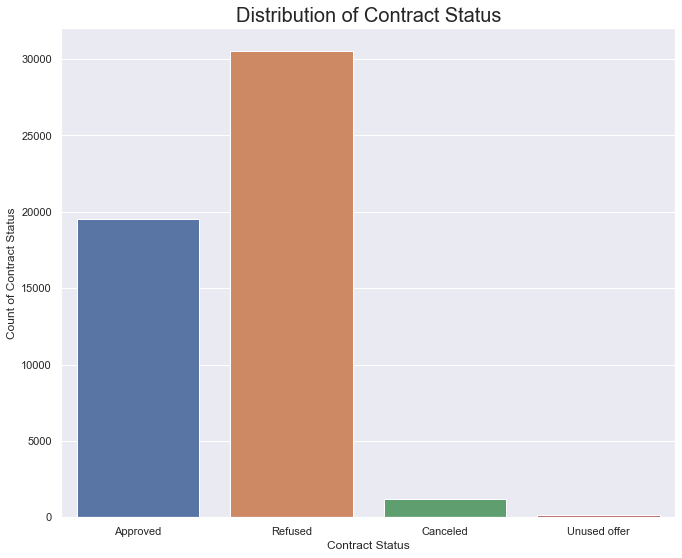

In [77]:
#Contract Status for Previous Application

plt.figure(figsize=[11,9])
sns.countplot(all_data['NAME_CONTRACT_STATUS'])
plt.xlabel("Contract Status")
plt.ylabel("Count of Contract Status")
plt.title("Distribution of Contract Status", fontsize=20)
plt.show()

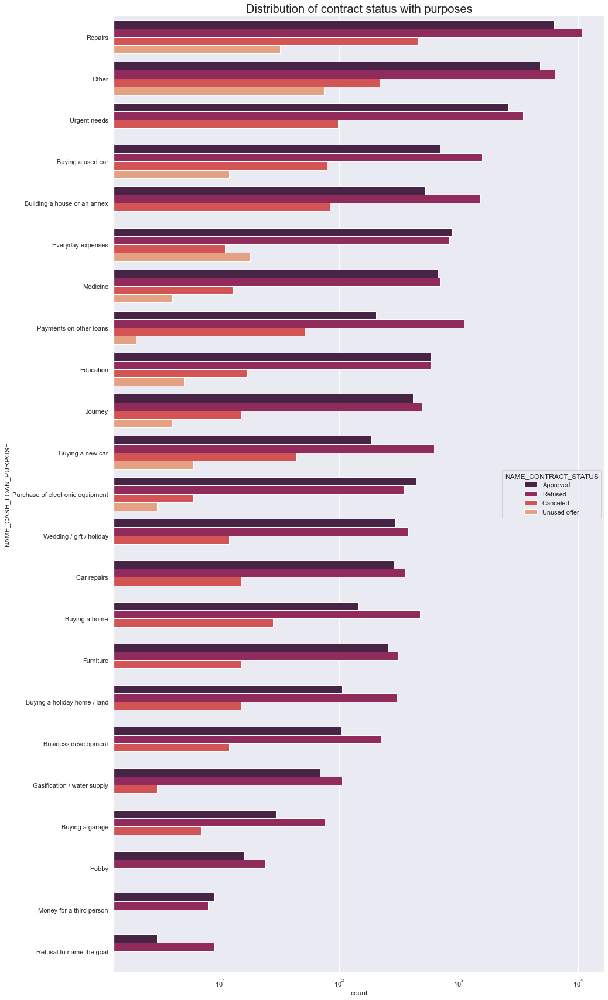

In [78]:
# Distribution of contract status in logarithmic scale

plt.figure(figsize=(15,30))
sns.countplot(data = all_data, y= 'NAME_CASH_LOAN_PURPOSE', 
                   order=all_data['NAME_CASH_LOAN_PURPOSE'].value_counts().index, hue = 'NAME_CONTRACT_STATUS', palette='rocket')

plt.xticks(rotation=0)
plt.xscale('log')
plt.title('Distribution of contract status with purposes', fontsize=20)
plt.show()

Observation:

1. Most rejection of loans came from purpose 'repairs'.
2. For education purposes we have equal number of approves and rejection
3. Paying other loans and buying a new car is having significant higher rejection than approves.

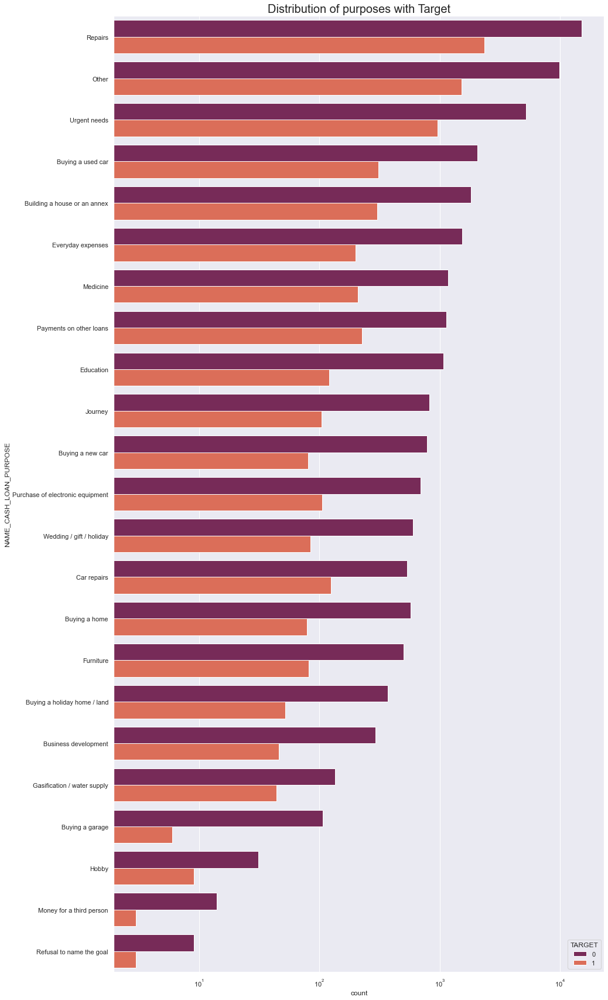

In [79]:
# Distribution of contract status

plt.figure(figsize=(15,30))
sns.countplot(data = all_data, y= 'NAME_CASH_LOAN_PURPOSE', 
                   order=all_data['NAME_CASH_LOAN_PURPOSE'].value_counts().index, hue = 'TARGET', palette='rocket')

plt.xticks(rotation=0)
plt.xscale('log')
plt.title('Distribution of purposes with Target', fontsize=20)
plt.show()

Observation:

1. Loan purposes with 'Repairs' are facing more difficulites in payment on time.
2. There are few places where loan payment is significant higher than facing difficulties. They are 'Buying a garage', 'Business developemt', 'Buying land','Buying a new car' and 'Education' Hence we can focus on these purposes for which the client is having for minimal payment difficulties.

#### Reasons of previous application rejection

In [80]:
# Reasons of previous application rejection

temp = prev_app["CODE_REJECT_REASON"].value_counts()
temp.iplot(kind='bar', xTitle = 'Reason', yTitle = "Count", title = 'Reasons of Previous Application Rejection')

Observation:

We observe that XAP is the reason majority of applications got rejected.

### 4.4 Bivariate analysis 

In [81]:
# Function for bivariate plots

from plotly.subplots import make_subplots
import plotly.graph_objects as go
def biplot(df,feature,title):
    temp = df[feature].value_counts()
    
    # Calculate the percentage of target=1 per category value
    perc = df[[feature, 'TARGET']].groupby([feature],as_index=False).mean()
    perc.sort_values(by='TARGET', ascending=False, inplace=True)

    fig = make_subplots(rows=1, cols=2,subplot_titles=("Count of "+ title,"% of Loan Payment difficulties within each category"))


    fig.add_trace(go.Bar(x=temp.index, y=temp.values),row=1, col=1)
    fig.add_trace(go.Bar(x=perc[feature].to_list(), y=perc['TARGET'].to_list()),row=1, col=2)
    fig['layout']['xaxis']['title']=feature
    fig['layout']['xaxis2']['title']=feature
    fig['layout']['yaxis']['title']='Count'
    fig['layout']['yaxis2']['title']='% of Loan Payment Difficulties'
    fig.update_layout(height=600, width=1000, title_text=title, showlegend=False)
    fig.show()

In [82]:
# Distribution of Contract Status and its category with maximum % of Loan-Payment Difficulties

biplot(all_data, 'NAME_CONTRACT_STATUS', 'CONTRACT STATUS')

Observation:

From the first graph it can be seen that most of the contracts from previous application have been Approved.

It can be clearly seen from the second graph that the - 

1. 'Refused' contracts from previous application are the ones who have maximum % of Loan-Payment Difficulties from current application.
2. 'Approved' contracts from previous application are the ones who have minimum % of Loan-Payment Difficulties from current application.

In [83]:
# Distribution of Cash Loan Purpose and its category with maximum % of Loan-Payment Difficulties 

biplot(all_data,'NAME_CASH_LOAN_PURPOSE', 'CASH LOAN PURPOSE')

Observation:

From the first graph it can be seen that purpose of cash loan from previous data was maximum for 'Repairs'

It can be clearly seen from the second graph that the

1. 'Refusal to name the goal' for cash loan from previous application are the ones who have maximum % of Loan-Payment Difficulties from current application.

## 5. Insights

### 5.1 Application Data

1. The count of ‘Lower Secondary’ in ‘NAME_EDUCATION_TYPE’ is comparatively very less and it also has maximum % of payment difficulties- around 11%. Hence, client with education type as ‘Lower Secondary’ are the driving factors for Loan Defaulters.


2. The count of ‘Maternity Leave’ in ‘NAME_INCOME_TYPE’ is very less and it also has maximum % of payment difficulties- around 40%. Hence, client with income type as ‘Maternity leave’ are the driving factors for Loan Defaulters.


3. The count of ‘Low skilled Laborers’ in ‘OCCUPATION_TYPE’ is comparatively very less and it also has maximum % of payment difficulties- around 17%. Hence, client with occupation type as ‘Low skilled Laborers’ are the driving factors for Loan Defaulters.



### 5.2 Previous Application Data


1. The count of ‘Revolving Loans’ in ‘NAME_CONTRACT_TYPE’ is comparatively very less and it also has maximum % of payment difficulties- around 10%. Hence, client with contract type as ‘Revolving loans’ in previous application are the driving factors for Loan Defaulters.


2. The count of ‘Refusal to name the goal’ in ‘NAME_CASH_LOAN_PURPOSE’ is comparatively very less and it also has maximum % of payment difficulties- around 23%. Hence, clients who have ‘Refused to name the goal’ for cash loan in previous application are the driving factors for Loan Defaulters.


3. The count of ‘Refused’ in ‘NAME_CONTRACT_STATUS’ is comparatively less and it also has maximum % of payment difficulties- around 12%. Hence, client with contract status as ‘Refused’ in previous application are the driving factors for Loan Defaulters.


4. It can be observed from the graph that Clients with 'Revolving loans' and with 'Refused' previous application tend to have more % of payment difficulties in current application. Since the count of both 'Revolving loans' and ‘Refused’ is comparatively less(from the graphs in previous slide), clients with ‘Revolving Loans’ and ‘Refused’ previous application are driving factors for Loan Defaulters

### 6. CONCLUSION is :

###### 1. Banks should focus more on contract type of ‘Student’ ,’Pensioner’ and ‘Businessman’ with housing ‘type other than ‘Co-op apartment’ for successful payments.

##### 2. Banks should focus less on income type ‘Working’ as they are having most number of unsuccessful payments.

##### 3. Also with loan purpose ‘Repair’ is having higher number of unsuccessful payments on time.